In [50]:
%matplotlib qt
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.colors import LogNorm
from matplotlib.ticker import FuncFormatter

# Insect Outbreak

## 1. Differential Equation

In [98]:
# Bifurcation Diagram
u = np.linspace(1.05, 10, 1000)
r = (2*u**3)/(1+u**2)**2
k = (2*u**3)/(u**2-1)

# x = np.linspace(0, 20, 100)

# k1 = 0.1
# r1 = 0.4
# if r1 >= 0:
#     r0 = 4
# else:
#     r0 = 4*np.exp(r1*x.max())
# if k1 >= 0:
#     k0 = 300
# else:
#     k0 = 300*np.exp(k1*x.max())

# plt.plot(k0*np.exp(-x*k1), r0*np.exp(-x*r1))

plt.plot(k, r)
plt.xlabel('Carrying Capacity (k)', fontsize=15)
plt.ylabel('Growth Rate (r)', fontsize=15)
plt.show()

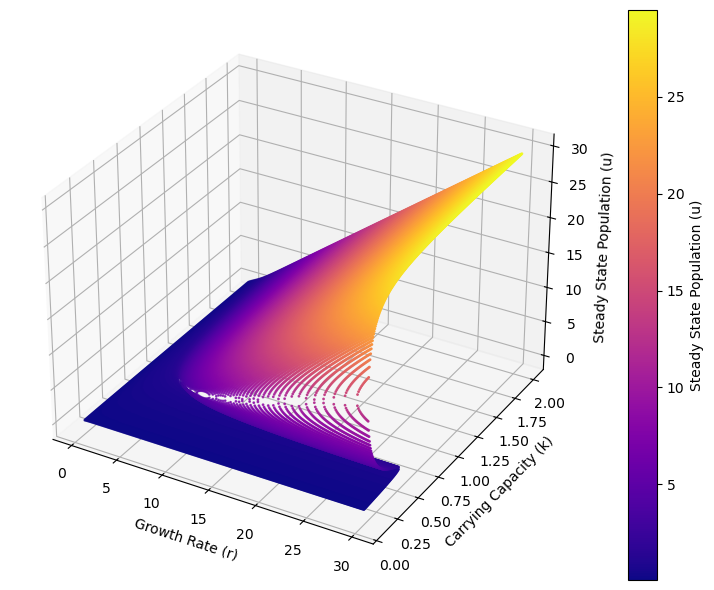

In [3]:
# Catastrophe Cusp Surface
r, k = np.meshgrid(np.linspace(0.1, 2, 300), np.linspace(0.1, 30, 300))

surf = []

for i in range(r.shape[0]):
    for j in range(r.shape[1]):
        R = r[i, j]
        K = k[i, j]
        
        coeff = [R, -R*K, (R+K), -R*K]
        roots = np.roots(coeff)
        real_roots = roots[np.isreal(roots)].real 
        for u in real_roots:
            surf.append((K, R, u))

surf = np.array(surf)
k_vals, r_vals, u_vals = surf[:, 0], surf[:, 1], surf[:, 2]

fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot(111, projection='3d')
sc = ax.scatter(k_vals, r_vals, u_vals, s=1, c=surf[:, 2], cmap='plasma')
ax.set_xlabel('Growth Rate (r)')
ax.set_ylabel('Carrying Capacity (k)')
ax.set_zlabel('Steady State Population (u)')

cbar = fig.colorbar(sc)
cbar.set_label('Steady State Population (u)')
fig.tight_layout()
plt.show()

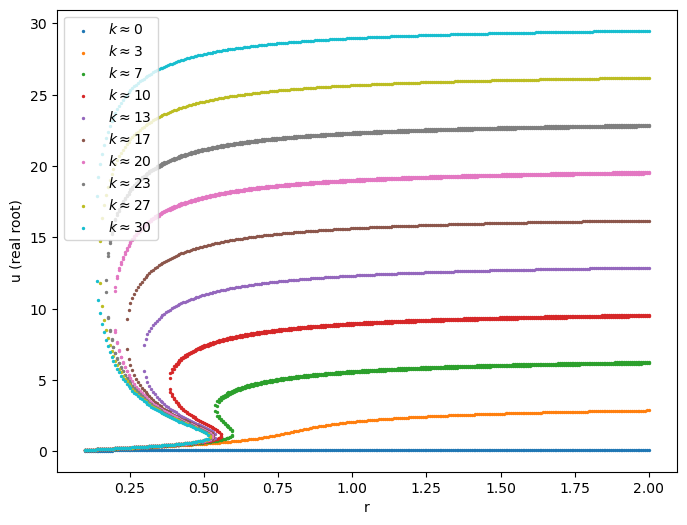

In [4]:
# u vs r

K = np.linspace(0.1, 30, 10)

plt.figure(figsize=(8, 6))

for k in K:
    eps = 0.07 

    mask = np.isclose(k_vals, k, atol=eps)
    r_sec = surf[mask][:, 1]
    u_sec = surf[mask][:, 2]
    
    plt.scatter(r_sec, u_sec, s=2, label=rf'$k\approx{k:.0f}$')


plt.xlabel("r")
plt.ylabel("u (real root)")
plt.legend()
plt.show()

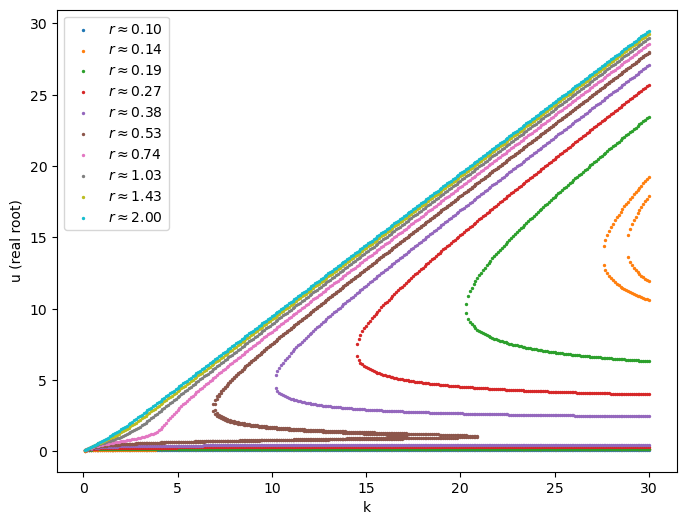

In [5]:
# u vs k

R = np.logspace(-1, 0.301, 10)

plt.figure(figsize=(8, 6))

for r in R:
    eps = 0.005 
    
    mask = np.isclose(r_vals, r, atol=eps)
    k_sec = surf[mask][:, 0]
    u_sec = surf[mask][:, 2]

    plt.scatter(k_sec, u_sec, s=2, label=rf'$r\approx{r:.2f}$')

plt.xlabel("k")
plt.ylabel("u (real root)")
plt.legend()
plt.show()

In [58]:
# Roots 
def alpha(r, k, u): 
    return r*(1-(2*u)/k) - (2*u)/(1+u**2)**2

r, k = np.meshgrid(np.linspace(0.1, 2, 100), np.linspace(0.1, 30, 100))

u = np.full((r.shape[0], r.shape[1], 3), np.nan)
a = np.full_like(u, np.nan)

for i in range(r.shape[0]):
    for j in range(r.shape[1]):
        R = r[i, j]
        K = k[i, j]

        coeff = [R, -R*K, (R + K), -R*K]
        roots = np.roots(coeff)
        real_roots = roots[np.isreal(roots)].real
        
        u[i, j, :len(real_roots)] = real_roots

        for idx, U in enumerate(real_roots): 
            a[i, j, idx] = alpha(R, K, U)

In [60]:
fig = plt.figure(figsize=(6, 6))
ax = fig.add_subplot(111, projection='3d')

for i in range(3):
    mask = ~np.isnan(u[:, :, i])
    ax.scatter(k[mask], r[mask], u[:, :, i][mask], s=1, label=f'Root {i + 1}')

ax.set_ylabel('Growth Rate (r)', fontsize=15)
ax.set_xlabel('Carrying Capacity (k)', fontsize=15)
ax.set_zlabel('Steady State Population (u)', fontsize=15)
plt.tight_layout()
plt.show()

## 2. Reaction-Diffusion Equation

### 2.1 Explicit Finite Difference

In [61]:
def final_population(u0, D, par, nt, dt, dx): 
    '''
    Numerically solves reaction-diffusion equation by explicit finite difference method 
    to generate final spatial population profile
    ------------
    Parameters
    ------------
    u0 : initial spatial population profile 
    D : diffusion coefficient of insects
    par : list of growth and carrying capacity parameters - r0, r1, k0, k1
    nt : The number of time steps to compute.
    dt : The time-step size to integrate.
    dx : The distance between two consecutive locations.
    
    Returns
    ------------
    x = space array
    t = time array
    uf = final spatial population profile
    
    '''
    # Parameters
    r1, k1, r0, k0 = par
    nx = len(u0)
    x = np.linspace(0, dx*(nx-1), nx)
    t = np.linspace(0, dt*nt, nt)

    # Spatially varying growth and carrying capacity
    r = r0*np.exp(-x*r1)
    k = k0*np.exp(-x*k1)

    u = u0.copy()

    for n in range(1, nt):
        u_new = u.copy()

        if r0 != 0 and k0 != 0: # Non-zero reaction (assuming there is growth)
            reaction = r * u * (1 - u / k) - u**2 / (1 + u**2)
        else:
            reaction = np.zeros_like(u)
            
        if D != 0: # Non-zero diffusion
            d2u_dx2 = np.zeros_like(u)
            d2u_dx2[1:-1] = (u[:-2] - 2*u[1:-1] + u[2:])/dx**2
            diffusion = D*d2u_dx2
        else: 
            diffusion = np.zeros_like(u)

        u_new[1:-1] = u[1:-1] + dt * (diffusion[1:-1] + reaction[1:-1])

        # Neumann boundary conditions
        u_new[0] = u_new[1]
        u_new[-1] = u_new[-2]

        # Ensure population is non-negative
        u_new = np.maximum(u_new, 0)

        u = u_new

    uf = u
    return x, t, uf

In [62]:
def population_time_series(u0, D, par, nt, dt, dx): 
    '''
    Numerically solves reaction-diffusion equation by explicit finite difference method 
    to generate time series of the spatial population profile
    ------------
    Parameters
    ------------
    u0 : initial spatial population profile 
    D : diffusion coefficient of insects
    par : list of growth and carrying capacity parameters - r0, r1, k0, k1
    nt : The number of time steps to compute.
    dt : The time-step size to integrate.
    dx : The distance between two consecutive locations.
    
    Returns
    ------------
    x = space array
    t = time array
    u_series = spatial population profile for all time steps 
    
    '''
    # Parameters
    r1, k1, r0, k0 = par
    nx = len(u0)
    x = np.linspace(0, dx*(nx-1), nx)
    t = np.linspace(0, dt*nt, nt)

    # Spatially varying growth and carrying capacity
    r = r0*np.exp(-x*r1)
    k = k0*np.exp(-x*k1)

    u_series = np.zeros((nt, nx))
    u = u0.copy()
    u_series[0, :] = u

    for n in range(1, nt):
        u_new = u.copy()

        if r0 != 0 and k0 != 0: # Non-zero reaction (assuming there is growth)
            reaction = r * u * (1 - u / k) - u**2 / (1 + u**2)
        else:
            reaction = np.zeros_like(u)
            
        if D != 0: # Non-zero diffusion
            d2u_dx2 = np.zeros_like(u)
            d2u_dx2[1:-1] = (u[:-2] - 2*u[1:-1] + u[2:])/dx**2
            diffusion = D*d2u_dx2
        else: 
            diffusion = np.zeros_like(u)

        u_new[1:-1] = u[1:-1] + dt * (diffusion[1:-1] + reaction[1:-1])

        # Neumann boundary conditions
        u_new[0] = u_new[1]
        u_new[-1] = u_new[-2]

        # Ensure population is non-negative
        u_new = np.maximum(u_new, 0)

        # Store and update values
        u_series[n, :] = u_new
        u = u_new

    return x, t, u_series

### 2.2 Verifying Numerical Method

In [105]:
'''
Monte Carlo simulation with no diffusion and no spatial gradient 
(reproducing result for no spatial gradient/diffusion)
'''

D = 0
r_values = np.linspace(0.1, 2, 30)
k_values = np.linspace(0.1, 30, 30)
nt, dt, dx = 3000, 0.01, 1
nx = 50
repeats = 5

results = []

for r0 in r_values:
    for k0 in k_values:
        u0 = np.logspace(-4, 5, nx)
        par = [0, 0, r0, k0]
        x, t, uf = final_population(u0, D, par, nt, dt, dx)
        uf = np.array(uf)
        
        if np.std(uf)*np.sqrt(len(uf)) >= 5:   
            uf_mid = (np.max(uf)-np.min(uf))/2
            low_vals = uf[uf < uf_mid]
            high_vals = uf[uf >= uf_mid]
            
            if len(low_vals) > 0:
                results.append((k0, r0, np.mean(low_vals)))
            if len(high_vals) > 0:
                results.append((k0, r0, np.mean(high_vals)))
        else:
            results.append((k0, r0, np.mean(uf)))

In [117]:
results = np.array(results)
fig = plt.figure(figsize=(10, 7))
ax = fig.add_subplot(111, projection='3d')
sc = ax.scatter(results[:, 0], results[:, 1], results[:, 2], c=results[:, 2], cmap='viridis', s=20)
ax.set_xlabel('Carrying Capacity (k)', fontsize=15)
ax.set_ylabel('Growth Rate (r)', fontsize=15)
ax.set_zlabel('Final Population (mean)', fontsize=15)
plt.colorbar(sc, label="Final Population (mean)")
plt.title("Pure Reaction", fontsize=15)
plt.tight_layout()
plt.show()

In [116]:
'''
Pure diffusion (no reaction) heatmap
'''
# Spatial parameter
nx = 100
dx = 0.1
x = np.linspace(0, dx*(nx-1), nx)

# Temporal parameters
nt = 1000
dt = 0.01

# Initial condition
u0 = np.exp(-((x-dx*(nx-1)/2)**2))

# Constant parameters
D = 0.4
par = (0, 0, 0, 0)

print(f'Stability Parameter = {D*dt/dx**2:.3f}')

x, t, u_series = population_time_series(u0, D, par, nt, dt, dx)

fig = plt.plot(figsize=(10, 6))

im = plt.imshow(u_series.T, extent=[t.min(), t.max(), x.min(), x.max()], 
                aspect='auto', origin='lower', cmap='viridis')

plt.xlabel("Time (t)")
plt.ylabel("Space (x)")
plt.title("Pure Diffusion")
plt.colorbar(im, label="Population (u)")
plt.tight_layout()
plt.show()

Stability Parameter = 0.400


Stability Parameter = 0.3999999999999999


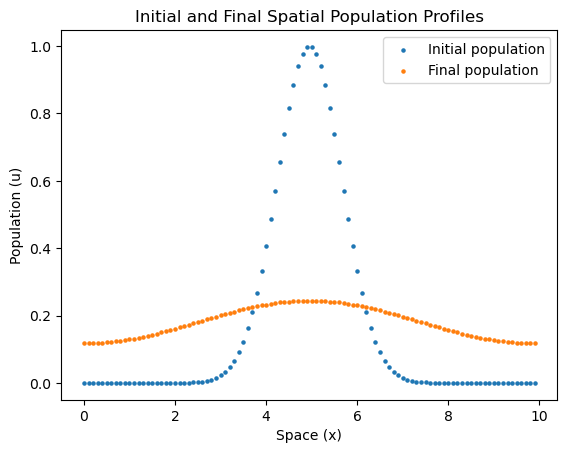

In [13]:
'''
Pure diffusion (no reaction) initial and final spatial profile
'''
nx = 100
dx = 0.1
x = np.linspace(0, dx*(nx-1), nx)

# Temporal parameters
nt = 1000
dt = 0.01

# Initial condition
u0 = np.exp(-((x-dx*(nx-1)/2)**2))

# Constant parameters
D = 0.4
par = (0, 0, 0, 0)

print(f'Stability Parameter = {D*dt/dx**2}')

x, t, uf = final_population(u0, D, par, nt, dt, dx)

plt.scatter(x, u0, s=5, label='Initial population')
plt.scatter(x, uf, s=5, label='Final population')
plt.xlabel('Space (x)')
plt.ylabel('Population (u)')
plt.title('Initial and Final Spatial Population Profiles')
plt.legend(loc='upper right')
plt.show()

### 2.3 Reaction-Diffusion Behaviour with Spatial Heterogeneity

Stability Parameter = 0.3999999999999999


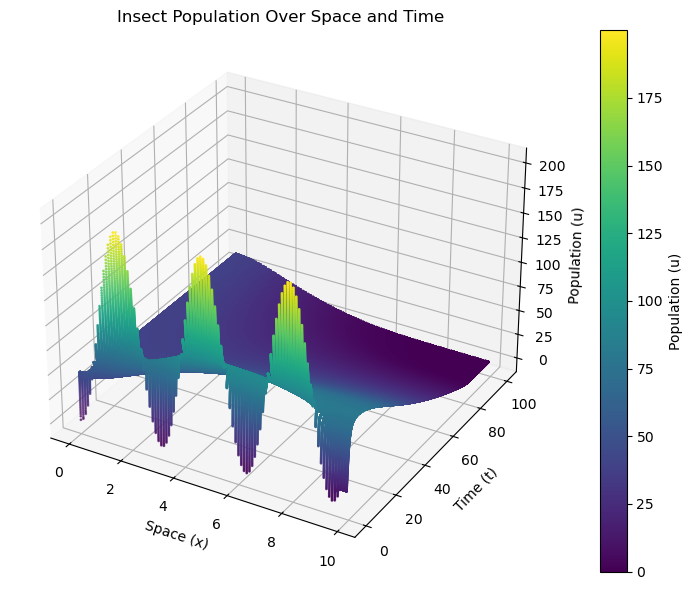

In [30]:
'''
Spatial profile time evolution
''' 
# Spatial parameter
nx = 100
dx = 0.1
x = np.linspace(0, dx*(nx-1), nx)

# Temporal parameters
nt = 10000
dt = 0.01

# Initial condition
# u0 = np.random.uniform(0, 100, nx)
u0 = 200*np.sin(x)**2

# Constant parameters
D = 0.4
r1 = 2
k1 = 0 
r0 = 4
k0 = 40

par = (r1, k1, r0, k0)

print(f'Stability Parameter = {D*dt/dx**2}')

x, t, u_series = population_time_series(u0, D, par, nt, dt, dx)

# Plot
T, X = np.meshgrid(t, x, indexing='ij')
U = u_series
X_plot = X.ravel()
T_plot = T.ravel()
U_plot = U.ravel()
fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot(111, projection='3d')
sc = ax.scatter(X_plot, T_plot, U_plot, c=U_plot, cmap='viridis', s=1)
ax.set_xlabel("Space (x)")
ax.set_ylabel("Time (t)")
ax.set_zlabel("Population (u)")
plt.colorbar(sc, label="Population (u)")
plt.title("Insect Population Over Space and Time")
plt.tight_layout()
plt.show()

Stability Parameter = 0.3999999999999999


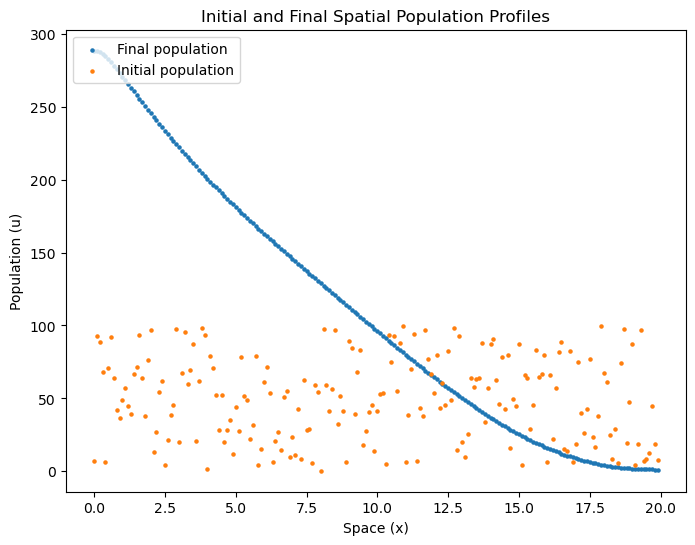

In [31]:
'''
Initial and final spatial profile
'''
# Spatial parameter
nx = 200
dx = 0.1
x = np.linspace(0, dx*(nx-1), nx)

# Temporal parameters
nt = 20000
dt = 0.01

# Initial condition
u0 = np.random.uniform(0, 100, nx)

# Constant parameters
D = 0.4
r1 = 0.4
k1 = 0.1
r0 = 4
k0 = 300
# if r1 >= 0:
#     r0 = 2
# else:
#     r0 = 2*np.exp(r1*x.max())
# if k1 >= 0:
#     k0 = 30
# else:
#     k0 = 30*np.exp(k1*x.max())
    
par = (r1, k1, r0, k0)

x, t, uf = final_population(u0, D, par, nt, dt, dx)

print(f'Stability Parameter = {D*dt/dx**2}')

plt.figure(figsize=(8, 6))
plt.scatter(x, uf, s=5, label=f'Final population')
plt.scatter(x, u0, s=5, label=f'Initial population')
plt.xlabel('Space (x)')
plt.ylabel('Population (u)')
plt.title('Initial and Final Spatial Population Profiles')
plt.legend(loc='upper left')
plt.show()

In [224]:
'''
Spatial profile time evolution heatmap
'''
# Spatial parameter
nx = 200
dx = 0.1
x = np.linspace(0, dx*(nx-1), nx)

# Temporal parameters
nt = 20000
dt = 0.01

# Initial condition
u0 = np.logspace(-2, 2, nx)

# Constant parameters
D = 0.1
r1 = -0.3
k1 = 0.1
if r1 >= 0:
    r0 = 4
else:
    r0 = 4*np.exp(r1*x.max())
if k1 >= 0:
    k0 = 300
else:
    k0 = 300*np.exp(k1*x.max())

print(f'r0 = {r0} \nk0 = {k0}')

par = (r1, k1, r0, k0)

print(f'Stability Parameter = {D*dt/dx**2}')

x, t, u_series = population_time_series(u0, D, par, nt, dt, dx)

plt.figure(figsize=(8, 6))
im = plt.imshow(u_series.T, extent=[t.min(), t.max(), x.min(), x.max()], 
                aspect='auto', origin='lower', cmap='viridis')

plt.xlabel("Time (t)", fontsize=15)
plt.ylabel("Space (x)", fontsize=15)
plt.title(f"D={D}")
plt.colorbar(im, label="Population (u)")
plt.tight_layout()
plt.show()

r0 = 0.010216965675971985 
k0 = 300
Stability Parameter = 0.09999999999999998


In [221]:
'''
Spatial heterogenity functions
'''
fig, ax = plt.subplots(1, 2, figsize=(8, 4))

r1, k1, r0, k0 = par
ax[0].plot(x, r0*np.exp(-x*r1))
ax[1].plot(x, k0*np.exp(-x*k1))
ax[0].set_xlabel('Space (x)', fontsize=15)
ax[1].set_xlabel('Space (x)', fontsize=15)
ax[0].set_ylabel('Growth Rate (r)', fontsize=15)
ax[1].set_ylabel('Carrying Capacity (k)', fontsize=15)
plt.tight_layout()
plt.show()

### 2.4 Parameter Space Explorations

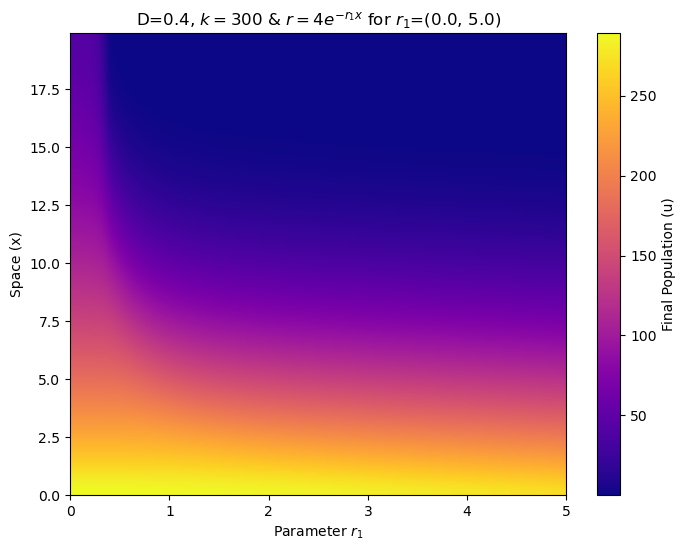

In [18]:
'''
Varying r1
'''

nx = 200
dx = 0.1
x = np.linspace(0, dx*(nx-1), nx)

nt = 20000
dt = 0.01

u0 = np.random.uniform(0, 100, nx)

D = 0.4
k0 = 300
k1 = 0.1
r0 = 4
r1_vals = np.linspace(0, 5, 200)

uf_all = []

for r1 in r1_vals:
    par = (r1, k1, r0, k0)
    x, t, uf = final_population(u0, D, par, nt, dt, dx)
    uf_all.append(uf)

uf_all = np.array(uf_all)

plt.figure(figsize=(8, 6))
extent = [r1_vals[0], r1_vals[-1], x[0], x[-1]]
#Use norm=LogNorm() to log the scale
plt.imshow(uf_all.T, aspect='auto', origin='lower', extent=extent, cmap='plasma') 
cbar = plt.colorbar()
cbar.set_label('Final Population (u)')
plt.xlabel(r'Parameter $r_1$')
plt.ylabel('Space (x)')
plt.title(rf'D={D}, $k={k0}$ & $r={r0}e^{{-r_1x}}$ for $r_1$=({r1_vals[0]}, {r1_vals[-1]})')
plt.show()

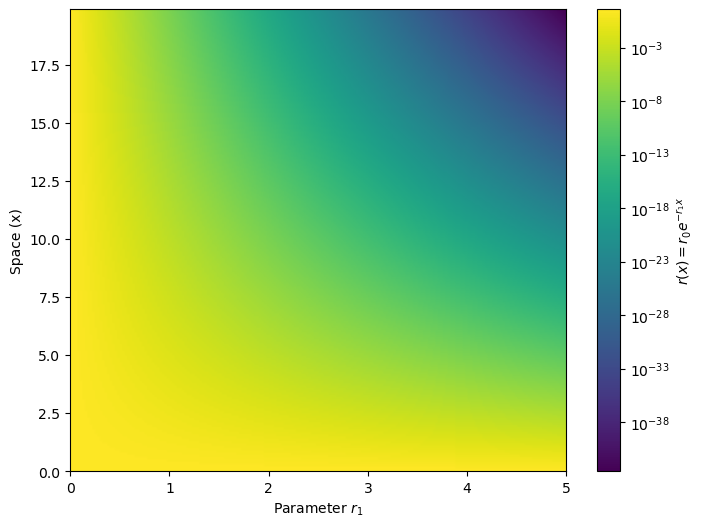

In [19]:
# Carrying capacity in space
r = np.array([r0*np.exp(-r1*x) for r1 in r1_vals])  

plt.figure(figsize=(8, 6))
extent = [r1_vals[0], r1_vals[-1], x[0], x[-1]]
plt.imshow(r.T, aspect='auto', origin='lower', extent=extent, cmap='viridis', norm=LogNorm())
cbar = plt.colorbar()
cbar.set_label(r'$r(x) = r_0 e^{-r_1 x}$')
plt.ylabel('Space (x)')
plt.xlabel(r'Parameter $r_1$')
plt.show()

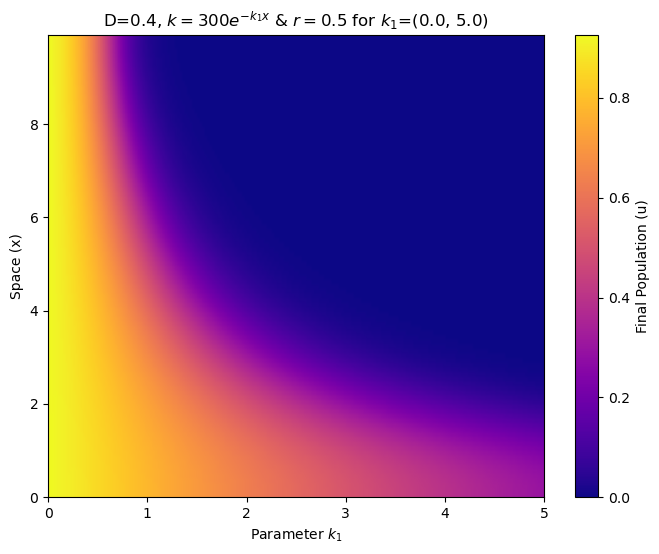

In [20]:
'''
Varying k1
'''

nx = 100
dx = 0.1
x = np.linspace(0, dx*(nx-1), nx)

nt = 20000
dt = 0.01

u0 = np.random.uniform(0, 2, nx)

D = 0.4
k0 = 300
r0 = 0.5
r1 = 0
k1_vals = np.linspace(0, 5, 200)

uf_all = []

for k1 in k1_vals:
    par = (r1, k1, r0, k0)
    x, t, uf = final_population(u0, D, par, nt, dt, dx)
    uf_all.append(uf)

uf_all = np.array(uf_all)

plt.figure(figsize=(8, 6))
extent = [k1_vals[0], k1_vals[-1], x[0], x[-1]]
#Use norm=LogNorm() to log the scale
plt.imshow(uf_all.T, aspect='auto', origin='lower', extent=extent, cmap='plasma') 
cbar = plt.colorbar()
cbar.set_label('Final Population (u)')
plt.ylabel('Space (x)')
plt.xlabel(r'Parameter $k_1$')
plt.title(rf'D={D}, $k={k0}e^{{-k_1x}}$ & $r={r0}$ for $k_1$=({k1_vals[0]}, {k1_vals[-1]})')
plt.show()

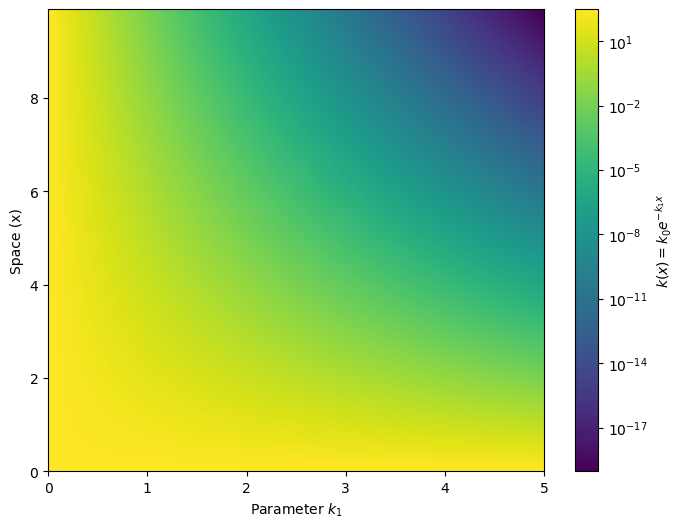

In [21]:
# Carrying capacity in space
k = np.array([k0*np.exp(-k1*x) for k1 in k1_vals])  

plt.figure(figsize=(8, 6))
extent = [k1_vals[0], k1_vals[-1], x[0], x[-1]]
plt.imshow(k.T, aspect='auto', origin='lower', extent=extent, cmap='viridis', norm=LogNorm())
cbar = plt.colorbar()
cbar.set_label(r'$k(x) = k_0 e^{-k_1 x}$')
plt.ylabel('Space (x)')
plt.xlabel(r'Parameter $k_1$')
plt.show()

In [228]:
'''
Combination of r1 and k1
'''

nx = 100
dx = 0.1
x = np.linspace(0, dx*(nx-1), nx)

nt = 20000
dt = 0.01

u0 = np.random.uniform(0, 2, nx)

D = 0.4
k0 = 300
r0 = 4
r1_vals = np.linspace(0.1, 5, 100)
k1_vals = np.linspace(0.1, 1, 12)

# Plot
fig, axs = plt.subplots(3, 4, figsize=(15, 10), sharex=True, sharey=True)
axs = axs.ravel()

for i, k1 in enumerate(k1_vals):
    uf_all = []
    
    for r1 in r1_vals:
        par = (r1, k1, r0, k0)
        x, t, uf = final_population(u0, D, par, nt, dt, dx)
        uf_all.append(uf)

    uf_all = np.array(uf_all)
    extent = [r1_vals[0], r1_vals[-1], x[0], x[-1]]

    #Use norm=LogNorm() to log the scale
    im = axs[i].imshow(uf_all.T, aspect='auto', origin='lower', extent=extent, cmap='plasma')
    axs[i].set_title(f'$k_1$ = {k1:.1f}')
    axs[i].set_ylabel('x', fontsize=12)
    axs[i].set_xlabel('$r_1$', fontsize=12)
    cbar = fig.colorbar(im, ax=axs[i])
    cbar.set_label('Final Population (u)', fontsize=12)
    cbar.ax.tick_params(labelsize=12)
    
plt.suptitle(rf'$D={D}$, $r={r0}e^{{-r_1x}}$, $k={k0}e^{{-k_1x}}$', fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()

In [227]:
'''
Varying D
'''

nx = 200
dx = 0.1
x = np.linspace(0, dx*(nx-1), nx)

nt = 20000
dt = 0.01

k1 = 0.1
r1 = 0.4
if r1 >= 0:
    r0 = 4
else:
    r0 = 4*np.exp(r1*x.max())
if k1 >= 0:
    k0 = 300
else:
    k0 = 300*np.exp(k1*x.max())
D_vals = np.logspace(-7, -0.4, 200)

uf_all = []

for D in D_vals:
    u0 = np.random.uniform(0, 100, nx)
    par = (r1, k1, r0, k0)
    x, t, uf = final_population(u0, D, par, nt, dt, dx)
    uf_all.append(uf)

uf_all = np.array(uf_all)

def log_format(x, pos):
    return r"$10^{%d}$" % int(np.round(x))
    
plt.figure(figsize=(8, 6))
extent = [np.log10(D_vals[0]), np.log10(D_vals[-1]), x[0], x[-1]]
#Use norm=LogNorm() to log the scale
plt.imshow(uf_all.T, aspect='auto', origin='lower', extent=extent, cmap='plasma') 

ax = plt.gca()
log_ticks = np.arange(-7, 0)
ax.set_xticks(log_ticks)
ax.xaxis.set_major_formatter(FuncFormatter(log_format))

cbar = plt.colorbar()
cbar.set_label('Final Population (u)')
plt.xlabel(r'Parameter $D$')
plt.ylabel('Space (x)')
plt.title(rf'$k={k0}e^{{-{k1}x}}$ & $r={r0}e^{{-{r1}x}}$ and $D$=({D_vals[0]:.0e}, {D_vals[-1]:.0e})')
plt.show()

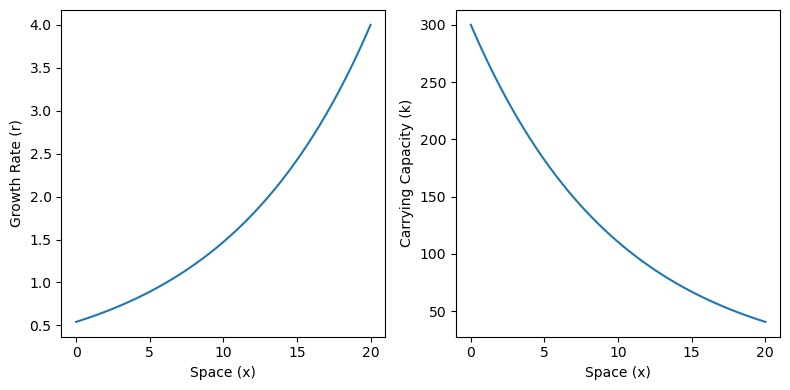

In [48]:
'''
Spatial heterogenity functions
'''
fig, ax = plt.subplots(1, 2, figsize=(8, 4))

x = np.linspace(0, 20, 100)

k1 = 0.1
r1 = -0.1
if r1 >= 0:
    r0 = 4
else:
    r0 = 4*np.exp(r1*x.max())
if k1 >= 0:
    k0 = 300
else:
    k0 = 300*np.exp(k1*x.max())

ax[0].plot(x, r0*np.exp(-x*r1))
ax[1].plot(x, k0*np.exp(-x*k1))
ax[0].set_xlabel('Space (x)')
ax[1].set_xlabel('Space (x)')
ax[0].set_ylabel('Growth Rate (r)')
ax[1].set_ylabel('Carrying Capacity (k)')
plt.tight_layout()
plt.show()

### 2.5 Animation

In [8]:
#@title Solver (launch this code to be able to solve the 1D PDEs below)

# The default method used by odeint is LSODA (Livermore Solver for Ordinary Differential Equations with Automatic switching)
# LSODA automatically switches between two types of methods depending on the nature of the system:
# Adams-Bashforth-Moulton (ABM) method for non-stiff problems.
# Backward Differentiation Formula (BDF) method for stiff problems.


import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import odeint
import sympy as sp
from sympy import symbols, cos, sin, pi, exp, diff, lambdify, floor, asin
from matplotlib.animation import FuncAnimation
import matplotlib.animation as animation
from matplotlib import rc
from IPython.display import HTML
import matplotlib as mpl
mpl.rcParams['animation.embed_limit'] = 100

t, x , u, rho= symbols('t x u rho')

def sol_RD_1D(times, space, fun_D, fun_F, fun_u0, BC = "Neumann"):
    # Parameters for spatial grid
    xmin = space[0]
    xmax = space[1]
    LX = xmax - xmin
    nx = space[2]
    dx = LX / nx

    # Grid
    xx = np.arange(xmin + dx, xmax + dx, dx)

    # Define symbols for sympy
    t, x, u, rho = symbols('t x u rho')

    # Convert sympy expressions to numpy functions
    num_u0 = lambdify((t, x), fun_u0, 'numpy')
    num_F = lambdify((t, x, u, rho), fun_F, 'numpy')
    num_D = lambdify((t, x), fun_D, 'numpy')

    # Initial condition
    U0 = num_u0(0,xx)

    # Diffusion matrix
    dA = np.ones(nx - 1)
    A = np.diag(dA, -1) - 2 * np.eye(nx) + np.diag(dA, 1)

    if BC == "Dirichlet":
        A[0, :] = 0  # Fix the first point (left boundary)
        A[-1, :] = 0  # Fix the last point (right boundary)
    elif BC == "Neumann":
        A[0, 0] = -1
        A[-1, -1] = -1  # Neumann (no flux) boundary

    A = A / (dx ** 2)

    # Solve using odeint
    def dynlattice(U, t):
        RHO= np.sum(U) * dx # integral term
        VF = num_F(t,xx,U,RHO) # reaction term
        MD = num_D(t,xx) # diffusion matrix
        return (A.dot(MD * U)) + VF # equation (RHS)

    # Use provided 'times' for the solution
    Y = odeint(dynlattice, U0, times)

    # Return the solution, spatial grid, and the times used for integration
    return Y, xx, times



def animplot_PDE1D(numerical_solution, xx, times):
    # Create the animation
    fig, ax = plt.subplots(figsize=(10, 6))
    line1, = ax.plot([], [], label="u(t,x)")
    ax.set_xlim(xx.min(), xx.max())
    ax.set_ylim(-0.1, 350)
    ax.legend()

    def init():
        line1.set_data([], [])
        return [line1]  # Return as a list to make it iterable

    def update(frame):
        t = times[frame]
        line1.set_data(xx, numerical_solution[frame])
        ax.set_title(f"Time: {t:.2f}")
        return [line1]  # Return as a list to make it iterable

    # Create the animation (use cache_frame_data=False to avoid caching data for large datasets)
    ani = FuncAnimation(fig, update, frames=len(times), init_func=init, blit=True, cache_frame_data=False)
    plt.close(fig)
    # Display animation using IPython's display function
    display(HTML(ani.to_jshtml()))



def animplot_PDE1D_MP4(numerical_solution, xx, times, video_filename = "animation_pde.mp4"): # save the simulation as a mp4 video
    # Create the animation
    fig, ax = plt.subplots(figsize=(8, 6))

    # Set the line and plot
    line1, = ax.plot([], [], label="u(t,x)",linewidth=4)
    ax.set_xlim(xx.min(), xx.max())
    ax.set_ylim(-0.1, 350)

    # Increase the font size of the legend
    ax.legend(fontsize=24)

    # Increase the font size for axis labels, title, and ticks
    ax.set_xlabel('x', fontsize=24)  # x-axis label
    ax.set_ylabel('u(t,x)', fontsize=24)  # y-axis label
    ax.tick_params(axis='both', which='major', labelsize=24)  # Tick labels
    ax.set_title('Solution at different times', fontsize=24, pad=20)  # Increased padding for the title

    # Adjust the layout to ensure the title is fully visible
    fig.tight_layout()  # Automatically adjust the padding
    fig.subplots_adjust(top=0.85)  # You can tweak the top margin to give more space for the title

    def init():
        line1.set_data([], [])
        return [line1]  # Return as a list to make it iterable

    def update(frame):
        t = times[frame]
        line1.set_data(xx, numerical_solution[frame])
        ax.set_title(f"Time: {t:.2f}", fontsize=24, pad=20)  # Dynamic title with larger font size and padding
        return [line1]  # Return as a list to make it iterable

    # Create the animation (use cache_frame_data=False to avoid caching data for large datasets)
    ani = FuncAnimation(fig, update, frames=len(times), init_func=init, blit=True, cache_frame_data=False)

    # Save the animation as an mp4 video

    ani.save(video_filename, writer='ffmpeg', fps=30)  # fps=30 is standard for smooth video

    plt.close(fig)
    print(f"Video saved as {video_filename}")

In [11]:
t, x , u, rho= symbols('t x u rho')
space = [0, 20, 500]

r1, k1 = 0.4, 0.1
if r1 >= 0:
    r0 = 4
else:
    r0 = 4*np.exp(r1*space[1])
if k1 >= 0:
    k0 = 300
else:
    k0 = 300*np.exp(k1*space[1])
    
r = r0*exp(-r1*x)
k = k0*exp(-k1*x)

fun_u0 = 10**(x/5 - 2)
fun_F = r*u*(1-u/k) - u**2/(1+u**2)
fun_D = 0.1

# Times to evaluate and plot
times = np.linspace(0, 200, 1000)

# Obtain numerical solution
numerical_solution, xx, _ = sol_RD_1D(times, space, fun_D, fun_F, fun_u0, "Neumann")

# Plot the solution
animplot_PDE1D(numerical_solution, xx, times)

In [12]:
animplot_PDE1D_MP4(numerical_solution, xx, times, video_filename = "Parallel_Grad.mp4")

Video saved as Parallel_Grad.mp4


In [135]:
'''
Spatial heterogenity functions
'''
x = np.linspace(space[0], space[1], space[2])

fig, ax = plt.subplots(1, 2, figsize=(8, 4))
ax[0].plot(x, r0*np.exp(-x*r1))
ax[1].plot(x, k0*np.exp(-x*k1))
ax[0].set_xlabel('Space (x)')
ax[1].set_xlabel('Space (x)')
ax[0].set_ylabel('Growth Rate (r)')
ax[1].set_ylabel('Carrying Capacity (k)')
plt.tight_layout()
plt.show()

## 3. Random Plots

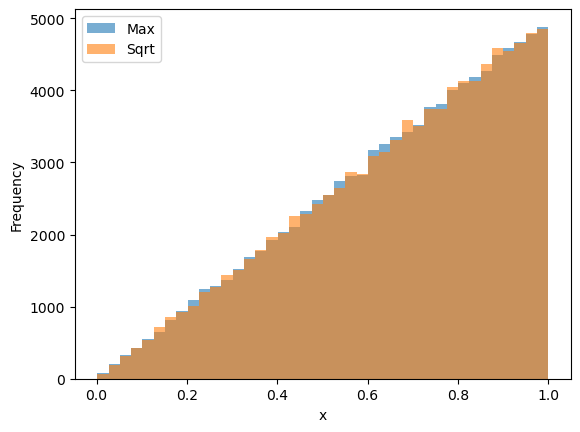

In [25]:
itr = 100000
max_x = np.zeros(itr)
sqrt_x = np.zeros(itr)

for i in range(itr):
    x1 = np.random.rand()
    x2 = np.random.rand()
    
    max_x[i] = np.max([x1, x2])
    sqrt_x[i] = np.sqrt(x1)

plt.hist(max_x, bins=40, alpha=0.6, label='Max')
plt.hist(sqrt_x, bins=40, alpha=0.6, label='Sqrt')
plt.xlabel('x')
plt.ylabel('Frequency')
plt.legend()
plt.show()

Converged in 6751 steps.


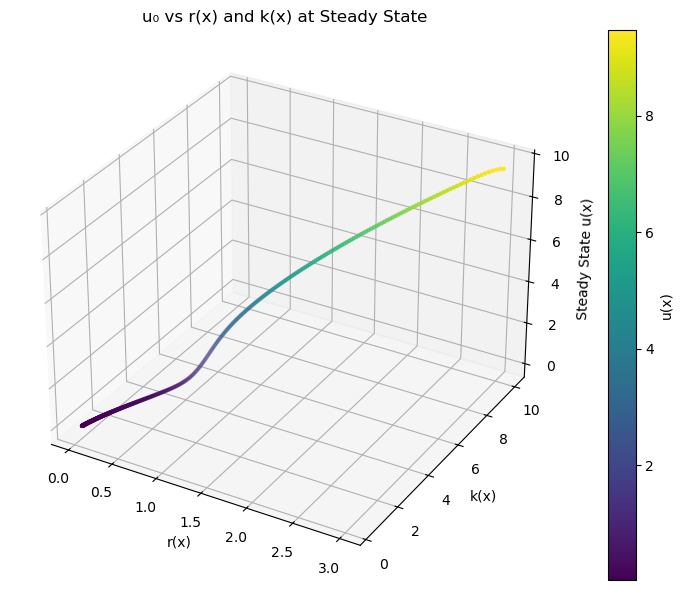

In [26]:
import numpy as np
import matplotlib.pyplot as plt

# Parameters
D = 0.5
r0, r1 = 3, 20
k0, k1 = 10, 30
x_max = 100
nx = 500
dx = x_max / (nx - 1)
dt = 0.01
max_steps = 10000
tolerance = 1e-6

# Spatial grid
x = np.linspace(0, x_max, nx)

# Heterogeneous environment
r_x = r0 * np.exp(-x / r1)
k_x = k0 * np.exp(-x / k1)

# Initial condition: small perturbation
u = 0.1 + 0.01 * np.random.rand(nx)

# Time stepping using Euler's method
for step in range(max_steps):
    u_new = np.copy(u)

    # Second derivative (finite difference)
    d2u_dx2 = np.zeros_like(u)
    d2u_dx2[1:-1] = (u[:-2] - 2*u[1:-1] + u[2:]) / dx**2

    # Reaction term
    reaction = r_x * u * (1 - u / k_x) - (u**2) / (1 + u**2)

    # Euler update
    u_new[1:-1] = u[1:-1] + dt * (D * d2u_dx2[1:-1] + reaction[1:-1])

    # Neumann BCs
    u_new[0] = u_new[1]
    u_new[-1] = u_new[-2]

    # Check for convergence
    if np.max(np.abs(u_new - u)) < tolerance:
        print(f"Converged in {step} steps.")
        break

    u = u_new

# === Final Steady State Data ===
# Scatter plot of u vs r(x) and k(x)
fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot(111, projection='3d')
sc = ax.scatter(r_x, k_x, u, c=u, cmap='viridis', s=5)

ax.set_xlabel("r(x)")
ax.set_ylabel("k(x)")
ax.set_zlabel("Steady State u(x)")
ax.set_title("u₀ vs r(x) and k(x) at Steady State")
plt.colorbar(sc, label="u(x)")
plt.tight_layout()
plt.show()

100%|██████████████████████████████████████████████████████████████████████████████████| 20/20 [01:45<00:00,  5.28s/it]


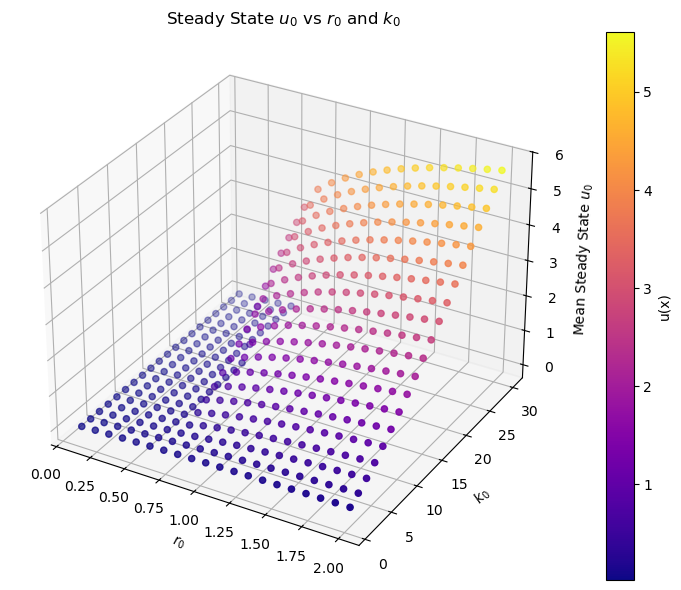

In [27]:
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm  # optional for progress bar

# Fixed Parameters
D = 0.5
r1 = 20
k1 = 30
x_max = 100
nx = 300
dx = x_max / (nx - 1)
dt = 0.01
max_steps = 10000
tolerance = 1e-6
x = np.linspace(0, x_max, nx)

# Arrays of parameter values
r0_vals = np.linspace(0.1, 2, 20)
k0_vals = np.linspace(1, 30, 20)

# Storage for 3D scatter data
R0, K0, U0 = [], [], []

# Loop over (r0, k0) pairs
for r0 in tqdm(r0_vals):
    for k0 in k0_vals:
        r_x = r0 * np.exp(-x / r1)
        k_x = k0 * np.exp(-x / k1)
        u = 0.1 + 0.01 * np.random.rand(nx)

        for step in range(max_steps):
            u_new = np.copy(u)
            d2u_dx2 = np.zeros_like(u)
            d2u_dx2[1:-1] = (u[:-2] - 2 * u[1:-1] + u[2:]) / dx**2
            reaction = r_x * u * (1 - u / k_x) - (u**2) / (1 + u**2)
            u_new[1:-1] = u[1:-1] + dt * (D * d2u_dx2[1:-1] + reaction[1:-1])
            u_new[0] = u_new[1]
            u_new[-1] = u_new[-2]

            if np.max(np.abs(u_new - u)) < tolerance:
                break
            u = u_new

        # Save average or specific spatial point (e.g., midpoint)
        U0.append(np.mean(u))  # Or u[nx//2] for central value
        R0.append(r0)
        K0.append(k0)

# === 3D Scatter Plot ===
fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot(111, projection='3d')
sc = ax.scatter(R0, K0, U0, c=U0, cmap='plasma', s=20)

ax.set_xlabel("$r_0$")
ax.set_ylabel("$k_0$")
ax.set_zlabel("Mean Steady State $u_0$")
ax.set_title("Steady State $u_0$ vs $r_0$ and $k_0$")
plt.colorbar(sc, label="u(x)")
plt.tight_layout()
plt.show()

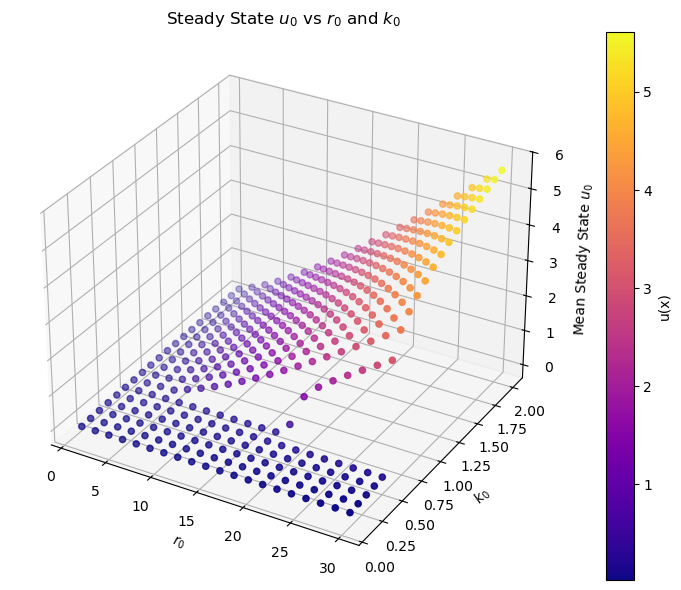

In [28]:
# === 3D Scatter Plot ===
fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot(111, projection='3d')
sc = ax.scatter(K0, R0, U0, c=U0, cmap='plasma', s=20)

ax.set_xlabel("$r_0$")
ax.set_ylabel("$k_0$")
ax.set_zlabel("Mean Steady State $u_0$")
ax.set_title("Steady State $u_0$ vs $r_0$ and $k_0$")
plt.colorbar(sc, label="u(x)")
plt.tight_layout()
plt.show()

In [14]:
# Uniform Gradient 
def alpha(r, k, u): 
    return r*(1-(2*u)/k) - (2*u)/(1+u**2)**2
    
def grad_alpha(r0, r1, k0, k1, x_max):
    x_vals = np.linspace(0, x_max, 5000)
    a_vals = np.full((len(x_vals), 3), np.nan)
    
    for i, x in enumerate(x_vals):
        r = r0*np.exp(-r1*x)
        k = k0*np.exp(-k1*x)
    
        coeff = [r, -r*k, (r + k), -r*k]
        roots = np.roots(coeff)
        real_roots = roots[np.isreal(roots)].real
    
        for j, u in enumerate(real_roots):
            a_vals[i, j] = alpha(r, k, u)
            
    return x_vals, a_vals

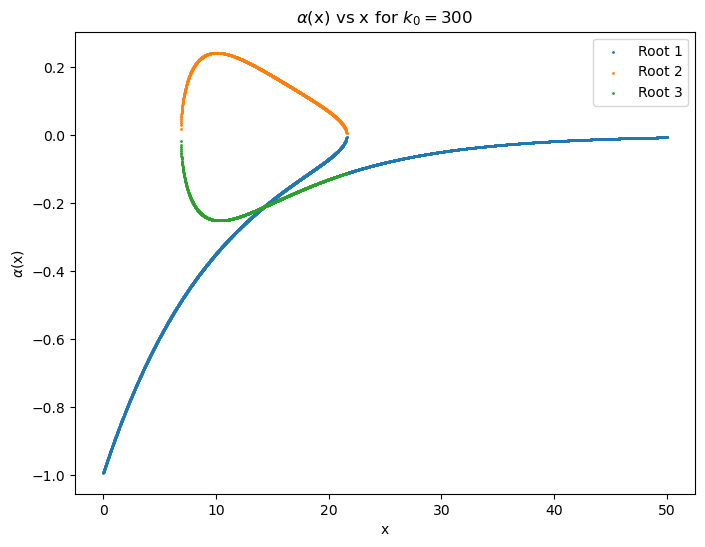

In [22]:
r0, r1 = 1, 0.1
k0, k1 = 300, 0.1
D = 0.4
x_max = 50

x, a = grad_alpha(r0, r1, k0, k1, x_max)

plt.figure(figsize=(8, 6))
for j in range(3):
    mask = ~np.isnan(a[:, j])
    plt.scatter(x[mask], a[mask, j], s=1, label=f'Root {j + 1}')
    
plt.xlabel("x")
plt.ylabel(r"$\alpha$(x)")
plt.title(rf"$\alpha$(x) vs x for $k_0={k0}$")
plt.legend()
plt.show()

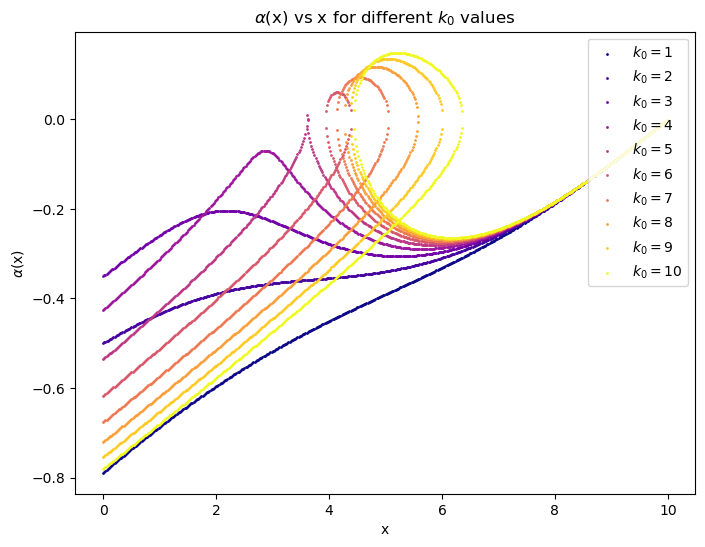

In [33]:
r0, r1 = 1, -0.1
k0, k1 = 10, 0.1
x_max = 100

plt.figure(figsize=(8, 6))

col = plt.cm.plasma(np.linspace(0, 1, 10)) 

for i, k0 in enumerate(range(1, 11)): 
    x, a = grad_alpha(r0, r1, k0, k1, x_max)
    for j in range(3):
        mask = ~np.isnan(a[:, j])
        plt.scatter(x[mask], a[mask, j], s=1, color=col[i], label=f'$k_0={k0}$' if j==0 else None)

plt.xlabel("x")
plt.ylabel(r"$\alpha$(x)")
plt.title(r"$\alpha$(x) vs x for different $k_0$ values")
plt.legend(loc='upper right')
plt.show()

C:\Users\Ayaan Dutt\AppData\Local\Temp\ipykernel_18032\1514006292.py:10: RuntimeWarning: invalid value encountered in sqrt
  lam = np.sqrt(-a)


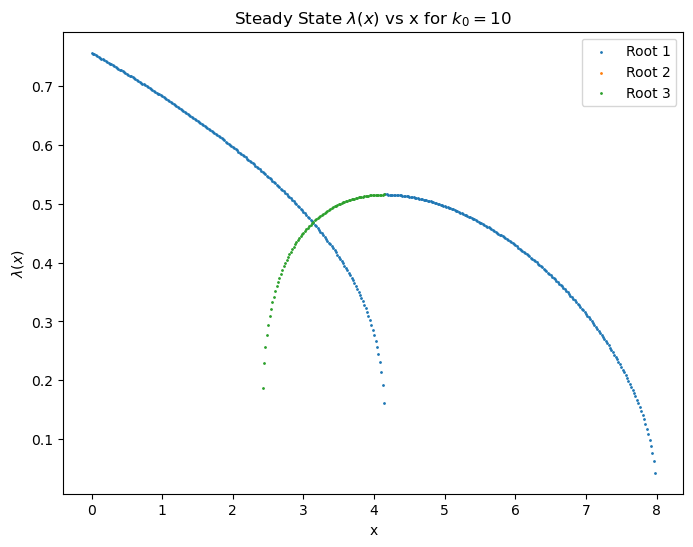

In [34]:
r0, r1 = 0.8, -0.1
k0, k1 = 10, 0
x_max = 100
A = 1

def eps(A, l, x):
    return A*np.exp(1j*l*x).real

x, a = grad_alpha(r0, r1, k0, k1, x_max)
lam = np.sqrt(-a)

plt.figure(figsize=(8, 6))
for j in range(3):
    mask = ~np.isnan(lam[:, j])
    plt.scatter(x[mask], lam[mask, j], s=1, label=f'Root {j + 1}')

plt.title(rf"Steady State $\lambda(x)$ vs x for $k_0={k0}$")
plt.xlabel("x")
plt.ylabel(r"$\lambda(x)$")
plt.legend()
plt.show()

C:\Users\Ayaan Dutt\AppData\Local\Temp\ipykernel_18032\98810389.py:11: RuntimeWarning: invalid value encountered in sqrt
  lam = np.sqrt(-a)


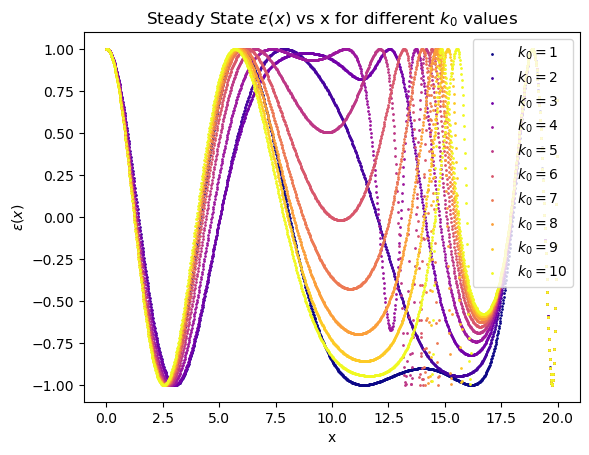

In [35]:
r0, r1 = 2, -0.1
k0, k1 = 30, 0
x_max = 100
A = 1

def eps(A, l, x):
    return A*np.exp(1j*l*x).real

for i, k0 in enumerate(range(1, 11)): 
    x, a = grad_alpha(r0, r1, k0, k1, x_max)
    lam = np.sqrt(-a)
    for j in range(3):
        mask = ~np.isnan(lam[:, j])
        plt.scatter(x[mask], eps(A, lam[mask, j], x[mask]), color=col[i], s=1, label=f'$k_0={k0}$' if j==0 else None)

plt.xlabel("x")
plt.ylabel(r"$\epsilon(x)$")
plt.title(r"Steady State $\epsilon(x)$ vs x for different $k_0$ values")
plt.legend(loc='upper right')
plt.show()

C:\Users\Ayaan Dutt\AppData\Local\Temp\ipykernel_18032\1711950735.py:9: RuntimeWarning: invalid value encountered in sqrt
  lam = np.sqrt(-a)


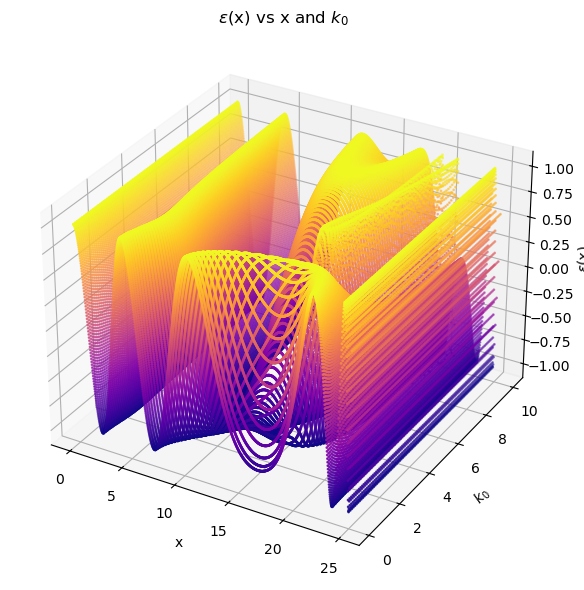

In [36]:
X_all, K0_all, EPS_all = [], [], []
r0, r1 = 2.5, -0.1
k0, k1 = 30, 0
x_max = 100
A = 1

for i, k0 in enumerate(np.linspace(0, 10, 100)): 
    x, a = grad_alpha(r0, r1, k0, k1, x_max)
    lam = np.sqrt(-a)
    for j in range(3):
        mask = ~np.isnan(lam[:, j])
        x_mask = x[mask]
        lam_mask = lam[mask, j]
        eps_vals = eps(A, lam_mask, x_mask)

        X_all.append(x_mask)
        K0_all.append(np.full_like(x_mask, k0))
        EPS_all.append(eps_vals)

# Flatten all data for scatter
X_all = np.concatenate(X_all)
K0_all = np.concatenate(K0_all)
EPS_all = np.concatenate(EPS_all)

# 3D Scatter Plot
fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot(111, projection='3d')
sc = ax.scatter(X_all, K0_all, EPS_all, c=EPS_all, cmap='plasma', s=1)

ax.set_xlabel("x")
ax.set_ylabel(r"$k_0$")
ax.set_zlabel(r"$\epsilon$(x)")
ax.set_title(r"$\epsilon$(x) vs x and $k_0$")

plt.tight_layout()
plt.show()

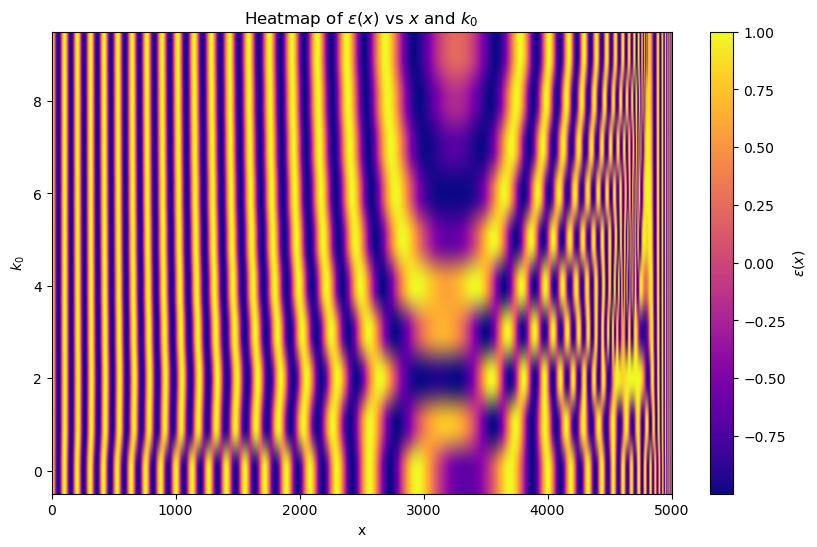

In [37]:
r0, r1 = 10, -0.1
k1 = 0
x_max = 100
A = 1

# Define grid
k0_vals = np.linspace(0.1, 10, 10)
X, K0 = np.meshgrid(x, k0_vals)
Z = np.zeros_like(X)

# Fill the Z matrix
for i, k0 in enumerate(k0_vals):
    x_vals, a = grad_alpha(r0, r1, k0, k1, x_max)
    lam = np.sqrt(np.maximum(0, -a[:, 0]))
    Z[i, :] = eps(A, lam, x_vals)

plt.figure(figsize=(10, 6))
plt.imshow(Z, origin='lower', aspect='auto', cmap='plasma')
plt.colorbar(label=r"$\epsilon(x)$")
plt.xlabel("x")
plt.ylabel(r"$k_0$")
plt.xlim(0, 5000)
plt.title(r"Heatmap of $\epsilon(x)$ vs $x$ and $k_0$")
plt.show()